## MSDS 452
## Assignment 5

## Bibliographic Networks

**Go to the Scopus Document Search webpage (under the Northwestern University VPN):** 

**https://www-scopus-com.turing.library.northwestern.edu/search/form.uri?display=basic**

**Select *Documents* (the default selection) and enter a search term (here I have used *machine learning*) in *Article Title, Abstract, Keywords* (to be selected at the right side of the *Search*).**

**Click *Published* and select *Added to Scopus in the last 30 days.***

**Click *Search* and in the obtained page click *All* and in "CSV export* select ONLY the following five attributes: *Author(s), Document title, Year, Source title, Include references.* Next, click "Export" to get the csv file of your results.**

<span style="color:red">**The resulting csv file should have at least 1,000 lines and at most (around) 2,000 lines. If there are less than 1,000 lines, adjust your selection in *Published* or change your search terms.**</span>

**Rename the obtained csv file to *Scopus_YourSearchTerm.csv* (here I have used *Scopus_machineLearning.csv*).**

In [1]:
from google.colab import drive
drive.mount('/content/gdrive/')

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


In [2]:
import pandas as pd
path = '/content/gdrive/MyDrive/MSDS452/Assignment5/'
df = pd.read_csv(path + 'scopus_deeplearning.csv')

In [3]:
len(df)

2000

In [15]:
#due to the computational difficulty, have to trim the size of file to 1000 lines. 

df = df[0:1001]
df.to_csv("/content/gdrive/MyDrive/MSDS452/Assignment5/scopus_deeplearning_trim.csv")

In [5]:
pip install datashader

In [6]:
!apt install libgraphviz-dev
!pip install pygraphviz

Reading package lists... Done
Building dependency tree       
Reading state information... Done
libgraphviz-dev is already the newest version (2.40.1-2).
The following packages were automatically installed and are no longer required:
  cuda-command-line-tools-10-0 cuda-command-line-tools-10-1
  cuda-command-line-tools-11-0 cuda-compiler-10-0 cuda-compiler-10-1
  cuda-compiler-11-0 cuda-cuobjdump-10-0 cuda-cuobjdump-10-1
  cuda-cuobjdump-11-0 cuda-cupti-10-0 cuda-cupti-10-1 cuda-cupti-11-0
  cuda-cupti-dev-11-0 cuda-documentation-10-0 cuda-documentation-10-1
  cuda-documentation-11-0 cuda-documentation-11-1 cuda-gdb-10-0 cuda-gdb-10-1
  cuda-gdb-11-0 cuda-gpu-library-advisor-10-0 cuda-gpu-library-advisor-10-1
  cuda-libraries-10-0 cuda-libraries-10-1 cuda-libraries-11-0
  cuda-memcheck-10-0 cuda-memcheck-10-1 cuda-memcheck-11-0 cuda-nsight-10-0
  cuda-nsight-10-1 cuda-nsight-11-0 cuda-nsight-11-1 cuda-nsight-compute-10-0
  cuda-nsight-compute-10-1 cuda-nsight-compute-11-0 cuda-nsight-co

In [7]:
import csv
import networkx as nx
import numpy as np
import math
import pandas as pd
import holoviews as hv
from holoviews.operation.datashader import datashade, bundle_graph
from networkx.algorithms import community
import pygraphviz
from networkx.drawing.nx_agraph import graphviz_layout
from networkx.drawing.nx_agraph import to_agraph 
from collections import Counter
from itertools import combinations, permutations

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)
warnings.simplefilter('ignore')

In [16]:
# # You need to collect your own dataset from Scopus!

datafile = '/content/gdrive/MyDrive/MSDS452/Assignment5/scopus_deeplearning_trim.csv' 
name = "Deep Learning" 
st = "Scopus bibliographic dataset on %s" %name

In [10]:
len(df)

1001

## 1. The Citation Network

In [11]:
node_list = [] # a list of titles and references
edge_list = [] # includes rows of format [a, b] where 'a' references 'b'
type_dict = {} # key: node, value: type ('title' or 'reference'), holds all possible node values

''' 
Requires: 'n_type' is either 'title' or 'reference' 
Modifies: If 'node' occurs in the list, preserves type 'title,' changing either 
          the 'node_list' value and the 'type_dict' type, or just the 'node' value.
          Else, adds 'node' to 'node_list.'
Effects:  Compares 'node' to the current 'note_list.' 
'''
def comp_add(node_list, node, n_type):
    for i in range(len(node_list)): 
        # check to see if 'node' compares to any current nodes
        if node in node_list[i] or node_list[i] in node: 
            # if a node exists as a row 'title' and a row 'reference', 
            # we want to favor the type 'title' in our data structures 
            if n_type == 'title': 
                # switch the representation in 'node_list' to 'title'
                node_list[i] = node
                type_dict[node] = n_type 
            else:
                # switch the representation of 'node' to 'title' 
                node = node_list[i]
            return node 
        
    # The rest of this function executes if 'node' is not already in 'node_list'
    if n_type == 'title':
        node_list.append(node)
        type_dict[node] = n_type
    else: 
        node_list.append(node)
        type_dict[node] = n_type

    return node

In [17]:
''' 
Main loop to parse data into nodes and edges. It takes a lot of time to run!
'''
cnt = 0
rows = 0
with open(datafile) as csv_file:
    reader = csv.DictReader(csv_file)
    for row in reader:
        rows += 1
        # Add node with unique identifier
        source_node = row['Title']
        source_node = comp_add(node_list, source_node, 'title')
        # Add an edge for each source and its references
        # Some rows may not any references. to check, verify 'refs' is a string
        if type(row['References']) != '':  
            cnt += 1
            refs = row['References'].split(';')
            for ref in refs:
                # Disregard web references, and clean data for any formatting inconsistencies
                if 'https://' not in ref and 'http://' not in ref and ref != " " and ref != "":  
                    ref = comp_add(node_list, ref, 'reference')
                    edge = [source_node, ref] # 'source_node' references 'ref'
                    edge_list.append(edge)

In [18]:
# Construction of the citation graph
G = nx.DiGraph()
for n in node_list: 
    G.add_node(n)
G.add_edges_from(edge_list)

# Remove nodes of degree 1
nodes_to_remove = []
for n in G.nodes(): 
    if G.degree(n) == 1: 
        nodes_to_remove.append(n)
G.remove_nodes_from(nodes_to_remove)

# Remove nodes that are isolated 
nodes_to_remove = []
for n in G.nodes(): 
    if G.degree(n) == 0: 
        nodes_to_remove.append(n)
G.remove_nodes_from(nodes_to_remove)

print("The citation graph of the %s has %i nodes and %i edges" %(st,len(G.nodes()),len(G.edges())))

The citation graph of the Scopus bibliographic dataset on Deep Learning has 1432 nodes and 2021 edges


### In the cell below, import modules, which can be used for the holoviews plot of networks

In [19]:
pip install chart_studio

In [20]:
pip install hvplot

Using data directory: /root/.bokeh/data
Skipping 'CGM.csv' (checksum match)
Skipping 'US_Counties.zip' (checksum match)
Skipping 'us_cities.json' (checksum match)
Skipping 'unemployment09.csv' (checksum match)
Skipping 'AAPL.csv' (checksum match)
Skipping 'FB.csv' (checksum match)
Skipping 'GOOG.csv' (checksum match)
Skipping 'IBM.csv' (checksum match)
Skipping 'MSFT.csv' (checksum match)
Skipping 'WPP2012_SA_DB03_POPULATION_QUINQUENNIAL.zip' (checksum match)
Skipping 'gapminder_fertility.csv' (checksum match)
Skipping 'gapminder_population.csv' (checksum match)
Skipping 'gapminder_life_expectancy.csv' (checksum match)
Skipping 'gapminder_regions.csv' (checksum match)
Skipping 'world_cities.zip' (checksum match)
Skipping 'airports.json' (checksum match)
Skipping 'movies.db.zip' (checksum match)
Skipping 'airports.csv' (checksum match)
Skipping 'routes.csv' (checksum match)
Skipping 'haarcascade_frontalface_default.xml' (checksum match)


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
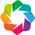

In [21]:
# Plotting-related
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
# from matplotlib import pyplot as plt
# from matplotlib.gridspec import GridSpec
from matplotlib.ticker import FuncFormatter
import matplotlib.colors as mcolors
import matplotlib._color_data as mcd
%matplotlib inline
import seaborn as sns
import plotly
from plotly import tools
# import plotly.plotly as py
import chart_studio.plotly as py
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
#connects JS to notebook so plots work inline
init_notebook_mode(connected=True)
# import bokeh
# from bokeh.io import push_notebook, show, output_notebook
# import bokeh.plotting as bp
# from bokeh.plotting import figure, save, output_file, show
# from bokeh.models import (ColumnDataSource, LabelSet, Label, BoxSelectTool, Circle, EdgesAndLinkedNodes, HoverTool,MultiLine, NodesAndLinkedEdges, Plot, Range1d, TapTool,)
# output_notebook()
# import holoviews as hv
# from holoviews import dim, opts
# hv.extension('bokeh', 'matplotlib')
# from holoviews.operation.datashader import datashade, bundle_graph
# import hvplot.pandas
# from holoviews.operation import gridmatrix
# # import IPython
# from IPython.display import display, HTML, Image
# # hv.notebook_extension()

import bokeh
from bokeh.io import push_notebook, show, output_notebook, save
import bokeh.plotting as bp
from bokeh.plotting import figure, save, output_file, show #, from_networkx
from bokeh.models import (ColumnDataSource, LabelSet, Label, BoxSelectTool, Circle, EdgesAndLinkedNodes, HoverTool,MultiLine, NodesAndLinkedEdges, Plot, Range1d, TapTool,)
from holoviews.element.graphs import layout_nodes
bokeh.sampledata.download()
from bokeh.sampledata.airport_routes import routes, airports

output_notebook()
import holoviews as hv
from holoviews import dim, opts
hv.extension('bokeh', 'matplotlib')
from holoviews.operation import  gridmatrix
from holoviews.operation.datashader import datashade, bundle_graph
from holoviews import Graph, Nodes
from holoviews.plotting.bokeh import GraphPlot, LabelsPlot
import hvplot.networkx as hvnx
import hvplot.pandas



### The holoviews plot function

In [44]:
# def connected_component_subgraphs(G):
#     for c in nx.connected_components(G):
#         yield G.subgraph(c)

def hvnx_plot(G,ctype,pos,width,height,node_size,node_cmap,edge_color,edge_line_width,
              title,bundled,nodelabels,xoffset,yoffset,
              arrowhead_length,selection_mode,selection_policy,
              edge_hover_line_color,node_hover_fill_color,
              fontsize,text_font_size, text_color,bgcolor):
    if nx.is_directed(G)==True:
        in_neighbors={} #arriving_airlines={}
        for n in G.nodes():
            t=list(G.predecessors(n))
            in_neighbors[n]=", ".join(sorted([x for x in t]))
#         print(in_neighbors)
        out_neighbors={} #departing_airlines={}
        for n in G.nodes():
            t=list(G.successors(n))
            out_neighbors[n]=", ".join(sorted([x for x in t])) 
#         print(out_neighbors)
        if ctype==1:
            communities_generator = community.girvan_newman(G)
            top_level_communities = next(communities_generator)
            next_level_communities = next(communities_generator)
            lc=sorted(sorted(map(sorted, next_level_communities)), key=len,reverse=True)
            partition={n:i for i,c in enumerate(lc) for n in c }
            print("No. of Girvan-Newman communities",len(set(partition.values())))
            for n in G.nodes():
                G.nodes[n]['Girvan_Newman_community'] = partition[n]
#                 if (n,n) in G.edges():
#                     G.nodes[n]['in-degree'] = 0
#                     G.nodes[n]['in-neighbors'] = ""
#                     G.nodes[n]['out-degree'] = 0
#                     G.nodes[n]['out-neighbors'] = ""
#                 else:    
                G.nodes[n]['in-degree'] = G.in_degree(n)
                G.nodes[n]['in_neighbors'] = in_neighbors[n] 
#                     G.nodes[n]['arriving airlines'] = arriving_airlines[n] 
                G.nodes[n]['out-degree'] = G.out_degree(n)
                G.nodes[n]['out_neighbors'] = out_neighbors[n] 
#                     G.nodes[n]['departing airlines'] = departing_airlines[n] 
            graph = hvnx.draw(G, pos)
            graph.opts(edge_color=edge_color,edge_line_width=edge_line_width,node_size=node_size,node_color='Girvan_Newman_community',node_cmap=node_cmap)
            if bundled==0:                
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))
                    print(labels)
                    return graph
                else:
                    return graph
            else:
                graph = bundle_graph(graph)
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))
                    return graph
                else:
                    return graph
        if ctype==0:
            print("Louvain communities are not computable for directed graphs!")
    else:
        connections={}
        for n in G.nodes():
            t=list(G.neighbors(n))
            connections[n]=", ".join(sorted([x for x in t]))
#         connected_components={}
#         Gcc = sorted(connected_component_subgraphs(G), key = len, reverse=True)
#         ccl=[list(g.nodes) for g in Gcc]
#     #     ccl=sorted(ccl, key=lambda item: len(item[1]), reverse=True)
#         for i,j in enumerate(ccl):
#             for n in j:
#                 connected_components[n]=i 
        if ctype==1:
            communities_generator = community.girvan_newman(G)
            top_level_communities = next(communities_generator)
            next_level_communities = next(communities_generator)
            lc=sorted(sorted(map(sorted, next_level_communities)), key=len,reverse=True)
            partition={n:i for i,c in enumerate(lc) for n in c }
#             print("No. of connected components",len(ccl))
            print("No. of Girvan-Newman communities",len(set(partition.values())))
            for n in G.nodes():
                G.nodes[n]['Girvan-Newman_community'] = partition[n]
#                 if (n,n) in G.edges():
#                     G.nodes[n]['degree'] = 0
#                     G.nodes[n]['connections'] = ""
# #                     G.nodes[n]['connected_component'] = connected_components[n]
#                 else:    
                G.nodes[n]['degree'] = G.degree(n)
                G.nodes[n]['connections'] = connections[n] #", ".join([str(x) for x in list(G.neighbors(n))])
#                     G.nodes[n]['connected_component'] = connected_components[n]
    #         for n in G.nodes():
    #             G.nodes[n]['Louvain_community'] = partition[n]
            graph = hvnx.draw(G, pos)
            graph.opts(edge_color=edge_color,edge_line_width=edge_line_width,node_size=node_size,node_color='Girvan-Newman_community',node_cmap=node_cmap)
            graph.opts(padding=0.15)
            if bundled==0:
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))            
                    return graph
                else:
                    return graph
            else:
                graph = bundle_graph(graph)
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))
                    return graph
                else:
                    return graph
        if ctype==0:
            partition_l=louvain.best_partition(G)
#             print("No. of connected components",len(ccl))
            print("No. of Louvain communities",len(set(partition_l.values())))
            for n in G.nodes():
                G.nodes[n]['Louvain_community'] = partition_l[n]
                if (n,n) in G.edges():
                    G.nodes[n]['degree'] = 0
                    G.nodes[n]['connections'] = ""
        #             G.nodes[n]['connected_component'] = connected_components[n]
                else:    
                    G.nodes[n]['degree'] = G.degree(n)
                    G.nodes[n]['connections'] = connections[n] #", ".join([str(x) for x in list(G.neighbors(n))])  #connections          
        #             G.nodes[n]['connected_component'] = connected_components[n]
            graph = hvnx.draw(G, pos)
            graph.opts(edge_color=edge_color,edge_line_width=edge_line_width,node_size=node_size,node_color='Louvain_community',node_cmap=node_cmap)
            graph.opts(padding=0.15)
            if bundled==0:                
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))
                    return graph
                else:
                    return graph
            else:
                graph = bundle_graph(graph)
                graph.opts(selection_policy=selection_policy,title=title,edge_hover_line_color=edge_hover_line_color,node_hover_fill_color=node_hover_fill_color,fontsize=fontsize,width=width,height=height,arrowhead_length=arrowhead_length) #,tools=tools) #,'box_zoom',"tap"])
                if nodelabels==1:
                    labels = hv.Labels(graph.nodes, ['x', 'y'], 'index')
                    graph=(graph * labels.opts(xoffset=xoffset, yoffset=yoffset,text_font_size=text_font_size, text_color=text_color, bgcolor=bgcolor))
                    return graph
                else:
                    return graph



### The holoviews plot of the citation graph. (Unbundled, nolabeled. Adjust parameters and title. Make sure that the size of nodes is such that the circles of nodes are not overlapping.)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
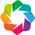

No. of Girvan-Newman communities 25


In [26]:
hv.extension('bokeh')

# Let us consider 4 days during which the number of tweets (nodes of the corresponding graph of hashtags) is moderately high:

ctype=1
node_color="Girvan-Newman_community"  #'Louvain_community' "connected_component"
bundled=1
nodelabels=0
width=1000
height=1000
node_size=2*np.log(5+hv.dim('degree')) #4*np.log(6+hv.dim('in-degree'))
node_cmap="tab10"
edge_line_width=1
edge_color='olive'
arrowhead_length=0.04
selection_mode='nodes'
selection_policy="nodes"
edge_hover_line_color='green'
node_hover_fill_color='red'
fontsize={'title': '9pt'}
text_font_size='4pt'
text_color='black'
bgcolor='white'
xoffset=0
yoffset=-0.03 #-15
    
title="Network Graph of Citation on Deep Learning"
pos=graphviz_layout(G)
g0=hvnx_plot(G,ctype,pos,width,height,node_size,node_cmap,edge_color,edge_line_width,
             title,bundled,nodelabels,xoffset,yoffset,
             arrowhead_length,selection_mode,selection_policy,
             edge_hover_line_color,node_hover_fill_color,
             fontsize,text_font_size, text_color,bgcolor)



In [27]:
from bokeh.plotting import show

show(hv.render(g0))

Text(0.5, 1.0, 'histgram of citation in-degree distribution')

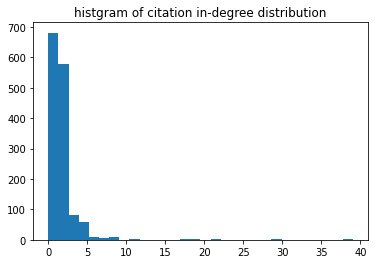

In [50]:
degrees = [val for (node, val) in G.in_degree()]
nodes = [node for (node, val) in G.in_degree()]

plt.hist(degrees,30)
plt.title('histgram of citation in-degree distribution')


In [61]:
rank = sorted(G.in_degree, key=lambda x: x[1], reverse=True)

cite_id = pd.DataFrame(rank, columns = ['Title', 'Citations'])

print(cite_id.head(5))

print(cite_id.tail(5))

                                               Title  Citations
0   He, K., Zhang, X., Ren, S., Sun, J., Deep res...         39
1   LeCun, Y., Bengio, Y., Hinton, G., Deep learn...         29
2   Hochreiter, S., Schmidhuber, J., Long short-t...         22
3   LeCun, Y., Bengio, Y., Hinton, G., Deep learn...         19
4   Hochreiter, S., Schmidhuber, J., Long short-t...         17
                                                  Title  Citations
1427  Decision Fusion of Deep Learning and Shallow L...          0
1428  Pan-Sharpening Based on CNN+ Pyramid Transform...          0
1429  Estimation of Fine-Grained Foot Strike Pattern...          0
1430  AutoCellANLS: An Automated Analysis System for...          0
1431  A Survey of the Four Pillars for Small Object ...          0


## 2. The Co-Citation Network

In [39]:
G1=G.copy()
medgesout=[]
n_out=[n for n in G1.nodes() if G1.out_degree(n)>1]
for n in n_out:
    nn=list(G1.successors(n))
    combs=combinations(nn, 2)
    for j in combs:
        medgesout.append((j[0],j[1]))
Gcocitation=nx.MultiGraph()
Gcocitation.add_edges_from(medgesout)
weight=[(x, y, {'weight': v}) for (x, y), v in Counter(Gcocitation.edges()).items()]
Gcocitation = nx.Graph(weight)
edge_width=[Gcocitation[u][v]['weight'] for u,v in Gcocitation.edges()]

st2="co-citation graph of the %s" %st
print("The %s has %i nodes and %i edges" %(st2,len(Gcocitation.nodes()),len(Gcocitation.edges())))

The co-citation graph of the Scopus bibliographic dataset on Deep Learning has 738 nodes and 3487 edges


### The holoviews plot of the co-citation graph. (Bundled, nolabeled, Louvain communities. Adjust parameters and title. Make sure that the size of nodes is such that the circles of nodes are not overlapping.)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
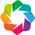

No. of Girvan-Newman communities 8


In [45]:
hv.extension('bokeh')

node_color="Girvan-Newman_community"  #'Louvain_community' "connected_component"
bundled=1
nodelabels=0
width=1000
height=1000
node_size=2*np.log(5+hv.dim('degree')) #4*np.log(6+hv.dim('in-degree'))
node_cmap="tab10"
edge_line_width=1
edge_color='olive'
arrowhead_length=0.04
selection_mode='nodes'
selection_policy="nodes"
edge_hover_line_color='green'
node_hover_fill_color='red'
fontsize={'title': '9pt'}
text_font_size='4pt'
text_color='black'
bgcolor='white'
xoffset=0
yoffset=-0.03 #-15
    
title="Co-Citation on Deep Learning"
pos=graphviz_layout(Gcocitation)
g1=hvnx_plot(Gcocitation,ctype,pos,width,height,node_size,node_cmap,edge_color,edge_line_width,
             title,bundled,nodelabels,xoffset,yoffset,
             arrowhead_length,selection_mode,selection_policy,
             edge_hover_line_color,node_hover_fill_color,
             fontsize,text_font_size, text_color,bgcolor)



In [46]:
from bokeh.plotting import show

show(hv.render(g1))

## 3. The Network of Bibliographic Coupling

In [47]:
G2=G.copy()
medgesin=[]
n_in=[n for n in G2.nodes() if G2.in_degree(n)>1]
for n in n_in:
    nn=list(G2.predecessors(n))
    combs=combinations(nn, 2)
    for j in combs:
        medgesin.append((j[0],j[1]))
Gbc=nx.MultiGraph()
Gbc.add_edges_from(medgesin)
weight=[(x, y, {'weight': v}) for (x, y), v in Counter(Gbc.edges()).items()]
Gbc = nx.Graph(weight)
edge_width=[Gbc[u][v]['weight'] for u,v in Gbc.edges()]

st4="graph of bibliographic coupling of the %s" %st
print("The %s has %i nodes and %i edges" %(st4,len(Gbc.nodes()),len(Gbc.edges())))

The graph of bibliographic coupling of the Scopus bibliographic dataset on Deep Learning has 679 nodes and 3661 edges


### The holoviews plot of the bibliographic coupling graph. (Bundled, nolabeled, Girvan-Newman communities. Adjust parameters and title. Make sure that the size of nodes is such that the circles of nodes are not overlapping.)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
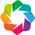

No. of Girvan-Newman communities 24


In [48]:
hv.extension('bokeh')

# Let us consider 4 days during which the number of tweets (nodes of the corresponding graph of hashtags) is moderately high:

ctype=1
node_color='Louvain_community' #"Girvan-Newman_community"  # "connected_component"
bundled=1
nodelabels=0
width=500
height=500
node_size=2*np.log(5+hv.dim('degree')) #4*np.log(6+hv.dim('in-degree'))
node_cmap="tab10"
edge_line_width=1
edge_color='olive'
arrowhead_length=0.04
selection_mode='nodes'
selection_policy="nodes"
edge_hover_line_color='green'
node_hover_fill_color='red'
fontsize={'title': '9pt'}
text_font_size='4pt'
text_color='black'
bgcolor='white'
xoffset=0
yoffset=-0.03 #-15
    
title="bibliographic coupling on Deep Learning"
pos=graphviz_layout(Gbc)
g2=hvnx_plot(Gbc,ctype,pos,width,height,node_size,node_cmap,edge_color,edge_line_width,
             title,bundled,nodelabels,xoffset,yoffset,
             arrowhead_length,selection_mode,selection_policy,
             edge_hover_line_color,node_hover_fill_color,
             fontsize,text_font_size, text_color,bgcolor)




In [49]:
from bokeh.plotting import show

show(hv.render(g2))